<a href="https://colab.research.google.com/github/Bepo2002/Humbug-4YP/blob/main/audio_mix_test.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [159]:
import zipfile
from scipy.io import wavfile
import pandas as pd
import numpy as np

# Function to extract sounds from zip - takes the sound id as input

def extract_sound(filename):
  zip_files = ['./drive/MyDrive/4YP/train.zip','./drive/MyDrive/4YP/dev.zip']
  folders = ['train/', 'dev/a/', 'dev/b/']
  dest_dir = './drive/MyDrive/4YP/Data'
  filename_to_extract = str(filename) + '.wav'

  for zip_path in zip_files:
    for folder in folders:
      with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        filename_to_extract = folder + filename_to_extract
        if filename_to_extract in zip_ref.namelist():
          zip_ref.extract(filename_to_extract, dest_dir)
          print(f"{filename_to_extract} has been extracted to {dest_dir}")
          final = './drive/MyDrive/4YP/Data/'+ filename_to_extract
          return wavfile.read(final)
  print(f"{filename_to_extract} not found in any of the provided ZIP files.")

# Read in .csv
metadata = pd.read_csv('./drive/MyDrive/4YP/Data/humbugdb_meta.csv')
metadata = metadata.set_index('id')

train/220008.wav has been extracted to ./drive/MyDrive/4YP/Data
Sample Rate: 44100 Hz


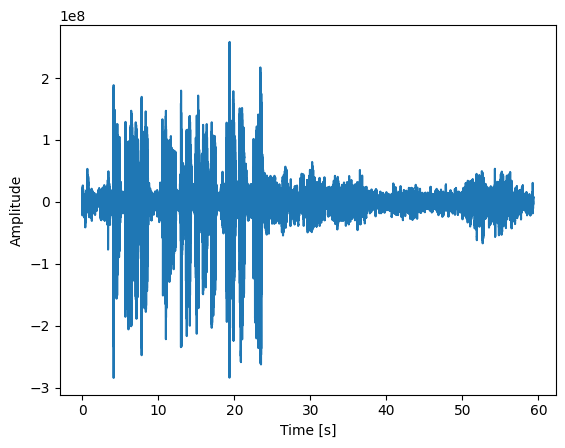

In [160]:
import matplotlib.pyplot as plt
from IPython.display import Audio

#Find some good noise

subset = metadata[metadata['sound_type'] == 'background']
subset = subset.loc[metadata['length'] > 30]
subset = subset.loc[metadata['sample_rate'] == 44100]
sel_noise = subset.sample()
noise_id = sel_noise.index.values[0]

# Import the sound wave and find samplerate
n_samplerate, noise = extract_sound(noise_id)

# Display Waveform and sound
print("Sample Rate: " + str(n_samplerate) + ' Hz')
def sound_plot(sound,ratey):
  plt.plot(np.linspace(0, len(sound)/ratey, num=len(sound)),sound)
  plt.xlabel('Time [s]')
  plt.ylabel('Amplitude')
  return Audio(sound,rate = n_samplerate)

sound_plot(noise,n_samplerate)

train/1122.wav has been extracted to ./drive/MyDrive/4YP/Data
Sample Rate: 44100 Hz


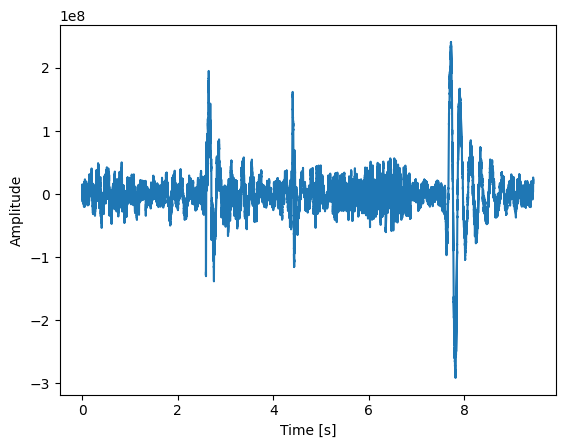

In [161]:
# MOSQUITO

subset = metadata[metadata['sound_type'] == 'mosquito']
subset = subset.loc[(metadata['length'] < 10) & (metadata['length'] > 3)]
subset = subset.loc[metadata['sample_rate'] == 44100]
sel_mos = subset.sample()
mos_id = sel_mos.index.values[0]

# Import the sound wave and find samplerate
samplerate, data = extract_sound(mos_id)

# Display Waveform and sound
print("Sample Rate: " + str(samplerate) + ' Hz')
sound_plot(data,samplerate)

2285491


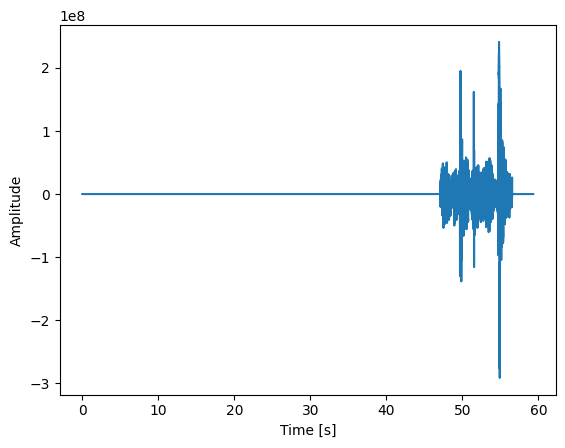

In [162]:
new_audio = np.zeros(noise.size)
sound_cat = np.zeros(noise.size)
mosquito_time = np.random.randint(data.size//2, high=noise.size-data.size//2, dtype=int)
print(mosquito_time)
new_audio[mosquito_time - data.size//2:mosquito_time + data.size//2] = data
sound_cat[mosquito_time - data.size//2:mosquito_time + data.size//2] = 1
sound_plot(new_audio,samplerate)

2285491

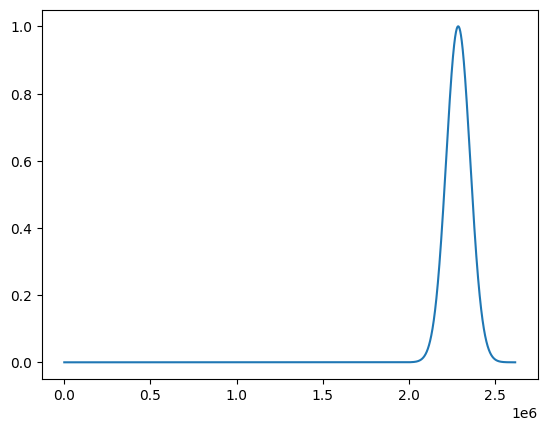

In [163]:
def gaussian(x, mu, sigma):
  return np.exp(-((x - mu)**2) / (2 * sigma**2))

x = np.linspace(0,noise.size,noise.size,dtype=int)

y = gaussian(x,mosquito_time,data.size/6)

plt.plot(x,y)
y.argmax(axis=0)

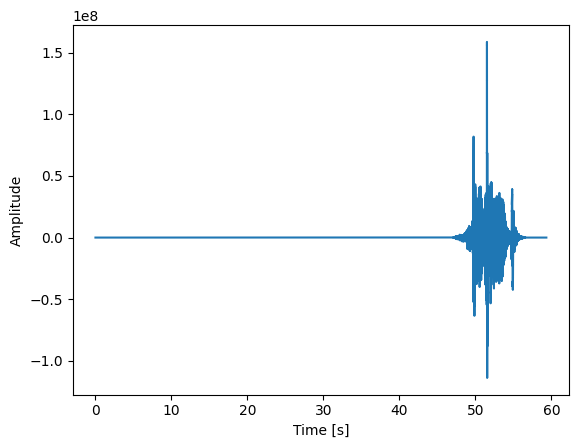

In [164]:
new_audio = y*new_audio
sound_plot(new_audio,samplerate)

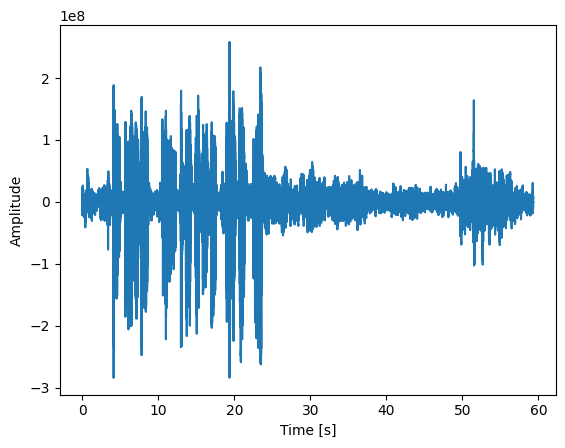

In [165]:
full_audio = noise + new_audio

sound_plot(full_audio,samplerate)